# Business Problem:

A Portuguese bank is gearing up to launch a term deposit subscription marketing campaign. The bank has data from a past marketing campaign, which will be used to offer insights to make a focused and successful campaign, so that bank will save a lot of money, time and resources. Additionally, we have created machine learning models to forecast the outcome for a potential future customer. 

# Dataset:

http://archive.ics.uci.edu/ml/datasets/Bank+Marketing#

The data is related with direct marketing campaigns of a Portuguese banking institution. The marketing campaigns were based on phone calls. Often, more than one contact to the same client was required, in order to access if the product (bank term deposit) would be ('yes') or not ('no') subscribed.

There are four datasets:
1) bank-additional-full.csv with all examples (41188) and 20 inputs, ordered by date (from May 2008 to November 2010), very close to the data analyzed in [Moro et al., 2014]

The classification goal is to predict if the client will subscribe (yes/no) a term deposit (variable y).


Attribute Information:

# Bank Client Data:
1 - age (numeric)

2 - job : type of job (categorical: 'admin.','blue-collar','entrepreneur','housemaid','management','retired','self-employed','services','student','technician','unemployed','unknown')

3 - marital : marital status (categorical: 'divorced','married','single','unknown'; note: 'divorced' means divorced or widowed)

4 - education (categorical: 'basic.4y','basic.6y','basic.9y','high.school','illiterate','professional.course','university.degree','unknown')

5 - default: has credit in default? (categorical: 'no','yes','unknown')

6 - housing: has housing loan? (categorical: 'no','yes','unknown')

7 - loan: has personal loan? (categorical: 'no','yes','unknown')

# Related with the Last Contact of the Current Campaign:
8 - contact: contact communication type (categorical: 'cellular','telephone')

9 - month: last contact month of year (categorical: 'jan', 'feb', 'mar', ..., 'nov', 'dec')

10 - day_of_week: last contact day of the week (categorical: 'mon','tue','wed','thu','fri')

11 - duration: last contact duration, in seconds (numeric). Important note: this attribute highly affects the output target (e.g., if duration=0 then y='no'). Yet, the duration is not known before a call is performed. Also, after the end of the call y is obviously known. Thus, this input should only be included for benchmark purposes and should be discarded if the intention is to have a realistic predictive model.
# Other Attributes:
12 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)

13 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric; 999 means client was not previously contacted)

14 - previous: number of contacts performed before this campaign and for this client (numeric)

15 - poutcome: outcome of the previous marketing campaign (categorical: 'failure','nonexistent','success')
# Social and Economic Context Attributes
16 - emp.var.rate: employment variation rate - quarterly indicator (numeric)

17 - cons.price.idx: consumer price index - monthly indicator (numeric)

18 - cons.conf.idx: consumer confidence index - monthly indicator (numeric)

19 - euribor3m: euribor 3 month rate - daily indicator (numeric)

20 - nr.employed: number of employees - quarterly indicator (numeric)

Output variable (desired target):

21 - y - has the client subscribed a term deposit? (binary: 'yes','no')

In [1]:
# Libraries used to complete project
import pandas as pd        
import seaborn as sns      
import numpy as np       
import matplotlib.pyplot as plt 
import plotly.express as px
from scipy import stats        
from sklearn.preprocessing import (LabelEncoder,StandardScaler)
from sklearn.metrics import (plot_confusion_matrix, roc_auc_score, accuracy_score, f1_score, confusion_matrix)
from sklearn.model_selection import (StratifiedKFold, train_test_split, GridSearchCV)
from sklearn.ensemble import (AdaBoostClassifier, RandomForestClassifier)
from sklearn.tree import DecisionTreeClassifier
import sklearn.metrics as metrics
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import (mean_squared_error, r2_score, accuracy_score, precision_score,
                             recall_score, f1_score)
import plotly.express as px
# from pandas_profiling import ProfileReport
from sklearn.metrics import make_scorer, fbeta_score
from IPython.display import IFrame
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


In [2]:
#Reading the dataset from the csv as a pandas dataframe

df= pd.read_csv(r'bank-additional-full.csv',sep=';')

### Data Frame

In [3]:
df

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,...,2,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes


In [4]:
df.shape

(41188, 21)

The data has 41188 rows and 21 columns

### Description of columns

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

Observation : The dataframe has object, integer and float attributes

In [6]:
df.isnull().sum()

age               0
job               0
marital           0
education         0
default           0
housing           0
loan              0
contact           0
month             0
day_of_week       0
duration          0
campaign          0
pdays             0
previous          0
poutcome          0
emp.var.rate      0
cons.price.idx    0
cons.conf.idx     0
euribor3m         0
nr.employed       0
y                 0
dtype: int64

Observation : There are no null values in the dataset

### Number of unique values in each column

In [7]:
df.nunique()

age                 78
job                 12
marital              4
education            8
default              3
housing              3
loan                 3
contact              2
month               10
day_of_week          5
duration          1544
campaign            42
pdays               27
previous             8
poutcome             3
emp.var.rate        10
cons.price.idx      26
cons.conf.idx       26
euribor3m          316
nr.employed         11
y                    2
dtype: int64

### Description of the numerical columns in Data Set

In [8]:
df.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41188.00000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000
mean,40.02406,258.285010,2.567593,962.475454,0.172963,0.081886,93.575664,-40.502600,3.621291,5167.035911
std,10.42125,259.279249,2.770014,186.910907,0.494901,1.570960,0.578840,4.628198,1.734447,72.251528
min,17.00000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,32.00000,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,38.00000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,47.00000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,98.00000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


The participants of the campaign have mean age of 40.02 years, the youngest person contacted was of 17 years and oldest person was of 98 years.

The max call duration that lasted during the previous campagin was 4918 seconds and on an average the call lasted for 258.2 seconds.

The same participant was contacted almost 2-3 times during the campaign. However, one client was contacted more than 50 times.

### How many people subscribed to the term deposit in last campaign
y is the target column

no     36548
yes     4640
Name: y, dtype: int64


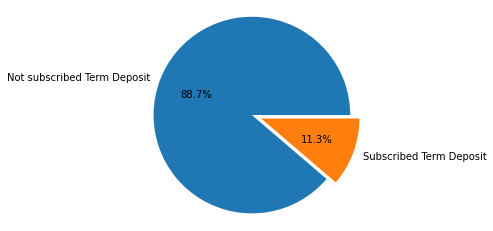

In [9]:
print(df.y.value_counts())

# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = 'Not subscribed Term Deposit','Subscribed Term Deposit'
explode = (0.1,0) 
fig1, ax1 = plt.subplots()
ax1.pie(df.y.value_counts(), explode=explode, labels=labels, startangle=0, autopct='%1.1f%%')
ax1.axis('equal')  

plt.show()

### Observation: The count value and the pie-chart above show that the dataset is highly imbalanced with lesser number of people who subscribed to term deposit

# Exploratory Data Analysis

In [10]:
IFrame(src='PD_Profile.html', width=950, height=600)

#### Exploring Categorical Columns

<AxesSubplot:xlabel='day_of_week', ylabel='count'>

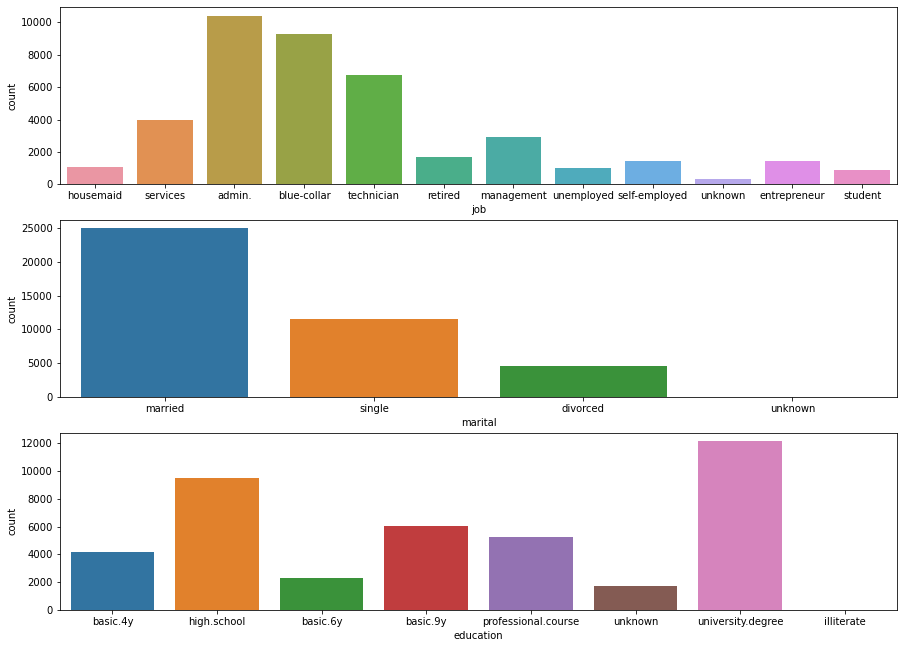

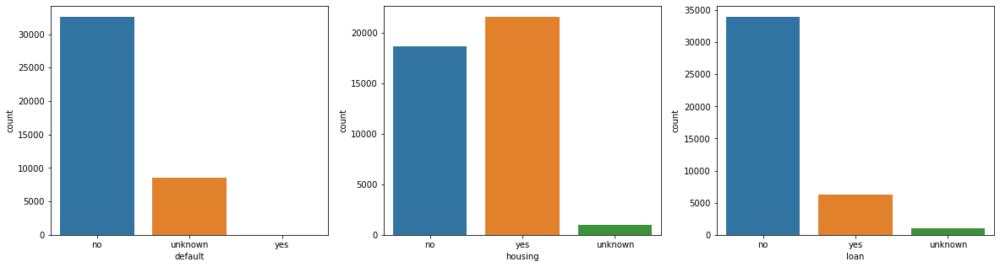

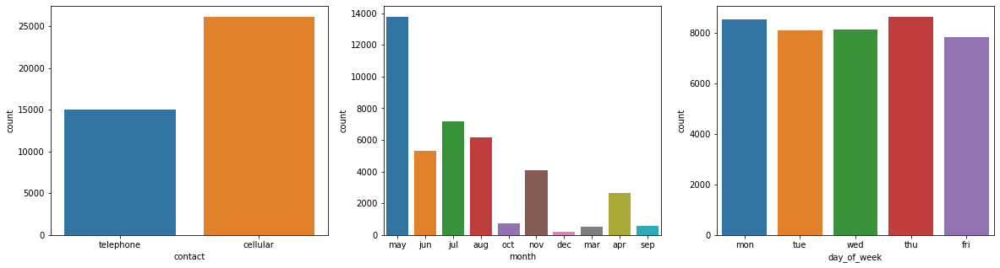

In [11]:
plt.figure(figsize=(15,15))
plt.subplot(4,1,1)
sns.countplot(df['job'])
plt.subplot(4,1,2)
sns.countplot(df['marital'])
plt.subplot(4,1,3)
sns.countplot(df['education'])
fig, (ax1, ax2, ax3) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'default', data = df, ax = ax1)
sns.countplot(x = 'housing', data = df, ax = ax2)
sns.countplot(x = 'loan', data = df, ax = ax3)
fig2, (ax4, ax5, ax6) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'contact', data = df, ax = ax4)
sns.countplot(x = 'month', data = df, ax = ax5)
sns.countplot(x = 'day_of_week', data = df, ax = ax6)

### Observation:
#### 1.The customers in the campaign mostly included people employed in administration role, technicians or in blue collar jobs.
#### 2.The majority of the customers contacted are married.
#### 3.The preferred mode to contact is cellular.
#### 4.The contacts made were highest in the month of May.
#### 5. Most customers have not defaulted on their credit.
#### 6.Majority of customers have a housing loan.
#### 7.There are very less people having any other loan to their name apart from Home Loan.
#### 8.Most customers contacted have passed High School or have a University Degree.
#### 9.The count is not much different for the contacts made each day per week.

<AxesSubplot:xlabel='job', ylabel='count'>

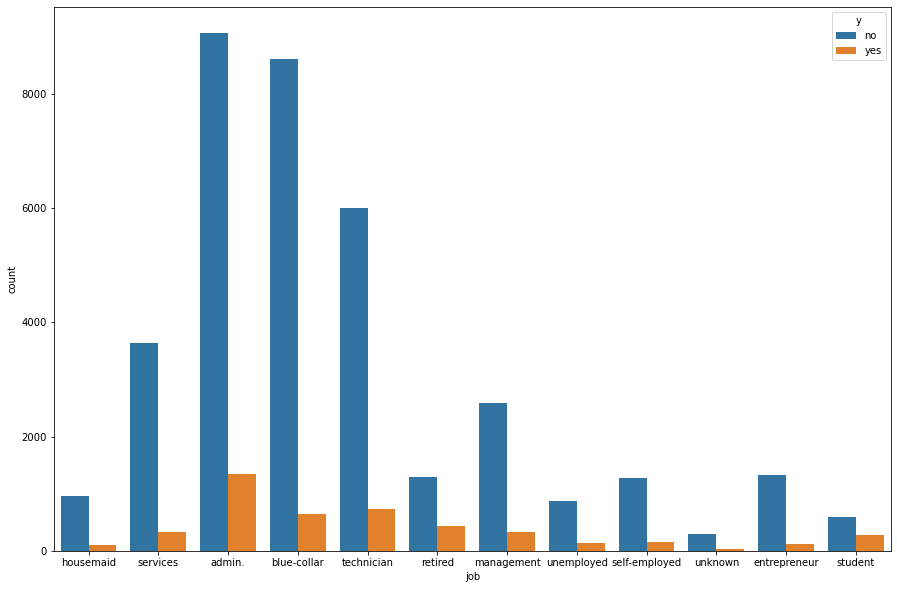

In [12]:
plt.figure(figsize=(15,10))
sns.countplot(x="job", data=df,hue="y")

#### Observation: the most number of people who are opting for term deposit has job profile of admin, blue collar & technician.

<AxesSubplot:xlabel='education', ylabel='count'>

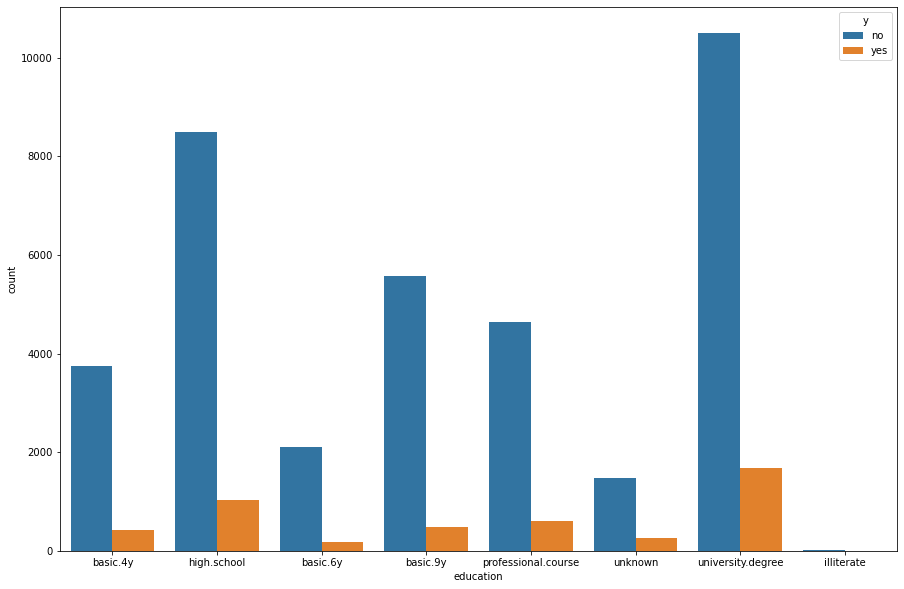

In [13]:
plt.figure(figsize=(15,10))
sns.countplot(x="education", data=df,hue="y")

#### Observation : Education background of most number of people who are subscribing to term deposit are having university degree

In [14]:
fig = px.scatter(df, x="campaign", y="duration", color="y")
fig.show()

#### Observation : The above scatter plot shows that the customers who were contacted less in frequency subscribed to the Term deposit more than the ones who got higher frequency of calls. The higher duration of calls also leads to a higher chance of subscribing the term deposit. Also, More the number of times the person is contacted in the campaign, they are less likely to subscribe.

In [15]:
df[df.duration==0]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
6251,39,admin.,married,high.school,no,yes,no,telephone,may,tue,...,4,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
23031,59,management,married,university.degree,no,yes,no,cellular,aug,tue,...,10,999,0,nonexistent,1.4,93.444,-36.1,4.965,5228.1,no
28063,53,blue-collar,divorced,high.school,no,yes,no,cellular,apr,fri,...,3,999,0,nonexistent,-1.8,93.075,-47.1,1.479,5099.1,no
33015,31,blue-collar,married,basic.9y,no,no,no,cellular,may,mon,...,2,999,0,nonexistent,-1.8,92.893,-46.2,1.299,5099.1,no


#### Observation : The duration of call for the above records was zero. Hence, obviously these 4 customers didn't subscribe for a term deposit.

<AxesSubplot:xlabel='contact', ylabel='count'>

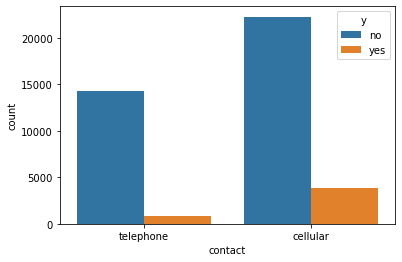

In [16]:
sns.countplot(x='contact',hue='y',data=df)

#### Observation: the most number of people who are opting for term deposit were contacted to their Cellphone

<AxesSubplot:xlabel='marital', ylabel='count'>

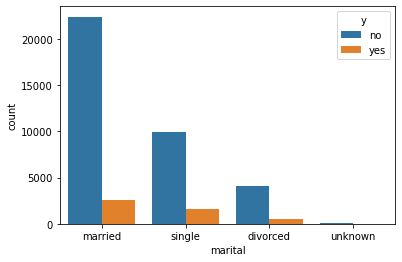

In [17]:
sns.countplot(x='marital',hue='y',data=df)

#### Observation: The highest number of successful term deposit customer come from people who are married and the lowest from those who are divorced

### Exploring Age Column

In [18]:
fig2 = px.histogram(data_frame=df, x='age')
fig2.show()

##### Observation: When we see that Age column is not normally distributed and it has many outliers. Before removing the outliers, let's explore how the outliers are correlated with target column.

In [19]:
fig = px.box(data_frame=df, x='age')
fig.show()

#### Age column has outliers. From box plot I can see that outliers are above the age of 70.
#### But there are more than 400 records for the age > 70

In [20]:
print("number of people more than 69 years of age - {}".format( len(df[(df.age > 69)])))
print("total number of people that subscribed to term deposit - {}".format( len(df[df['y'].str.contains('yes')])))
print("Number of people that subscribed to term deposit elder than 69 years of age - {}"
      .format( len(df[(df.age >= 70) & df['y'].str.contains('yes')])))

number of people more than 69 years of age - 469
total number of people that subscribed to term deposit - 4640
Number of people that subscribed to term deposit elder than 69 years of age - 221


#### There are total of 40k rows approx and out of which 11% subscribed to campaign that is 4.4k apporx.
#### There are only 1% of people (469) who are more than 69 years of age. Now from this, 50% people have subscibed to it. Which is also the 5% of the total term deposits.
#### Hence it seems the elder and retired people have subscribed to the campaign most & and are important to the campaign

### Exploring Duration Column

In [21]:
fig2 = px.box(data_frame=df, x='duration')
fig2.show()

In [22]:
print("Total Number of calls that lasted for more than 644 seconds - {}".format( len(df[df['duration'] > 644])))
print("Call conversion rate for calls that lasted for more than 644 seconds - {}"
      .format( len(df[(df['duration'] > 644) & df.y.str.contains('yes')])))

Total Number of calls that lasted for more than 644 seconds - 2963
Call conversion rate for calls that lasted for more than 644 seconds - 1526


#### One thing to note here is as the number of duration increases the outcome y becoming yes increases too. More than 50 % of the people subscribed to term deposit for the calls that lasted than 644 seconds.

In [23]:
fig2 = px.histogram(data_frame=df, x='duration')
fig2.show()

In [24]:
fig2 = px.histogram(data_frame=(df[(df.age >= 70) & df['y'].str.contains('yes')]), x='duration')
fig2.show()
fig3 = px.histogram(data_frame=(df[df['y'].str.contains('yes')]), x='duration')
fig3.show()

#### Observation: But one thing to note here is the persons who are more than 70 years of age does not talk much on phone and say yes for the campaign.

# Using Crosstab for Bivariate Analysis


y                    no       yes
job                              
admin.         0.870274  0.129726
blue-collar    0.931057  0.068943
entrepreneur   0.914835  0.085165
housemaid      0.900000  0.100000
management     0.887825  0.112175
retired        0.747674  0.252326
self-employed  0.895144  0.104856
services       0.918619  0.081381
student        0.685714  0.314286
technician     0.891740  0.108260
unemployed     0.857988  0.142012
unknown        0.887879  0.112121


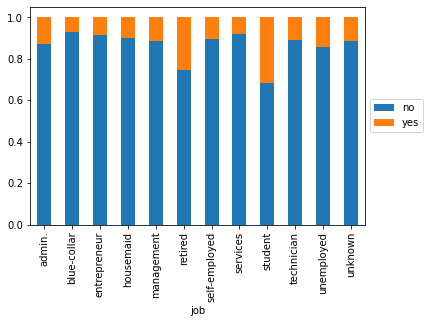

In [25]:

a = pd.crosstab(df['job'], df['y'], normalize='index')

print(a)
ct = pd.crosstab(df.job, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: The conversion rate is very high for student and retired professionals and it lowest for blue-collar worker

y               no       yes
marital                     
divorced  0.896791  0.103209
married   0.898427  0.101573
single    0.859959  0.140041
unknown   0.850000  0.150000


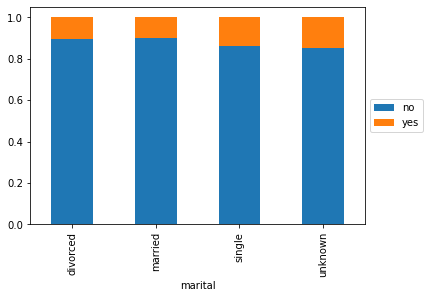

In [26]:
print(pd.crosstab(df['marital'], df['y'], normalize='index'))

ct = pd.crosstab(df.marital, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: Marital status does not influence term deposit subscription

y                          no       yes
education                              
basic.4y             0.897510  0.102490
basic.6y             0.917976  0.082024
basic.9y             0.921754  0.078246
high.school          0.891645  0.108355
illiterate           0.777778  0.222222
professional.course  0.886515  0.113485
university.degree    0.862755  0.137245
unknown              0.854997  0.145003


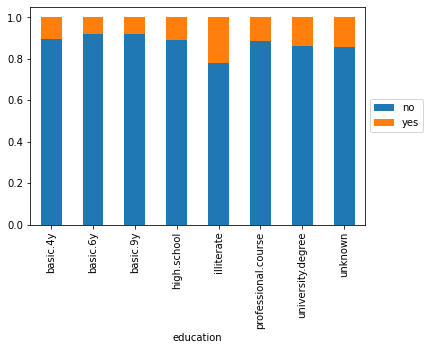

In [27]:
print(pd.crosstab(df['education'], df['y'], normalize='index'))
ct = pd.crosstab(df.education, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: Little surpised but the conversion rate of illiterate people is pretty high  

y             no      yes
default                  
no       0.87121  0.12879
unknown  0.94847  0.05153
yes      1.00000  0.00000


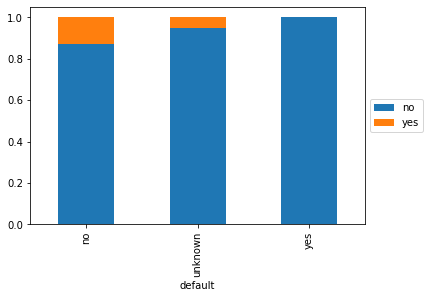

In [28]:
print(pd.crosstab(df['default'], df['y'], normalize='index'))

ct = pd.crosstab(df.default, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: People who have not yet defaulted on any loan repayment are likely to subscribe.

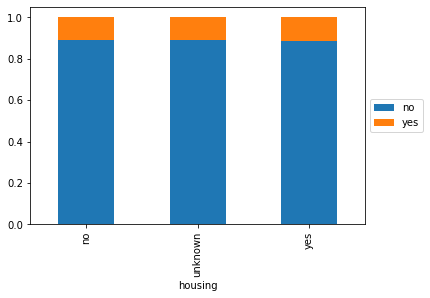

In [29]:
pd.crosstab(df['housing'], df['y'], normalize='index')


ct = pd.crosstab(df.housing, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: Housing loan doesn't influence the term deposit subscription much.

y              no       yes
loan                       
no       0.886598  0.113402
unknown  0.891919  0.108081
yes      0.890685  0.109315


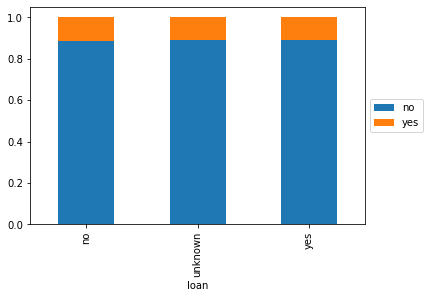

In [30]:
print(pd.crosstab(df['loan'], df['y'], normalize='index'))

ct = pd.crosstab(df.loan, df.y,normalize='index')
ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: Personal loan doesn't influence the term deposit subscription much.

y                no       yes
contact                      
cellular   0.852624  0.147376
telephone  0.947687  0.052313


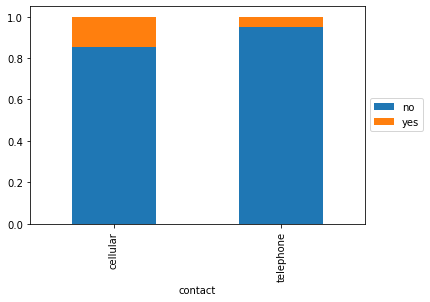

In [31]:
print(pd.crosstab(df['contact'], df['y'], normalize='index'))

ct = pd.crosstab(df.contact, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()



#### Observation : The conversion rate of cellular mode of contacting is more than telephone

y            no       yes
month                    
apr    0.795213  0.204787
aug    0.893979  0.106021
dec    0.510989  0.489011
jul    0.909534  0.090466
jun    0.894885  0.105115
mar    0.494505  0.505495
may    0.935653  0.064347
nov    0.898561  0.101439
oct    0.561281  0.438719
sep    0.550877  0.449123


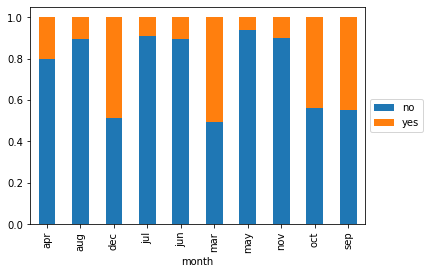

In [32]:
print(pd.crosstab(df['month'], df['y'], normalize='index'))

ct = pd.crosstab(df.month, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

Observation : The conversion rate is very high in the month of December, March, October and September

y                  no       yes
day_of_week                    
fri          0.891913  0.108087
mon          0.900517  0.099483
thu          0.878812  0.121188
tue          0.882200  0.117800
wed          0.883329  0.116671


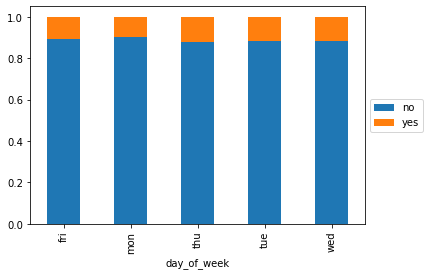

In [33]:
print(pd.crosstab(df['day_of_week'], df['y'], normalize='index'))

ct = pd.crosstab(df.day_of_week, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation : No particular trend seen on a particular day of the week


y               no       yes
campaign                    
1         0.869629  0.130371
2         0.885430  0.114570
3         0.892529  0.107471
4         0.906073  0.093927
5         0.924953  0.075047
6         0.923391  0.076609
7         0.939587  0.060413
8         0.957500  0.042500
9         0.939929  0.060071
10        0.946667  0.053333
11        0.932203  0.067797
12        0.976000  0.024000
13        0.956522  0.043478
14        0.985507  0.014493
15        0.960784  0.039216
16        1.000000  0.000000
17        0.931034  0.068966
18        1.000000  0.000000
19        1.000000  0.000000
20        1.000000  0.000000
21        1.000000  0.000000
22        1.000000  0.000000
23        0.937500  0.062500
24        1.000000  0.000000
25        1.000000  0.000000
26        1.000000  0.000000
27        1.000000  0.000000
28        1.000000  0.000000
29        1.000000  0.000000
30        1.000000  0.000000
31        1.000000  0.000000
32        1.000000  0.000000
33        1.00

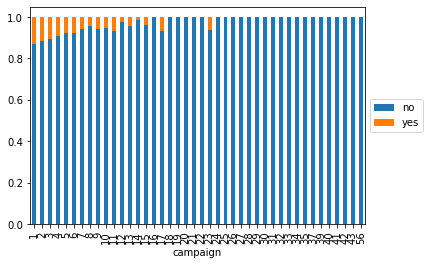

In [34]:
print(pd.crosstab(df['campaign'], df['y'], normalize='index'))


ct = pd.crosstab(df.campaign, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: As the number of calls increase the conversion rate decreases.

y            no       yes
pdays                    
0      0.333333  0.666667
1      0.692308  0.307692
2      0.393443  0.606557
3      0.321185  0.678815
4      0.466102  0.533898
5      0.369565  0.630435
6      0.298544  0.701456
7      0.333333  0.666667
8      0.333333  0.666667
9      0.453125  0.546875
10     0.423077  0.576923
11     0.464286  0.535714
12     0.551724  0.448276
13     0.222222  0.777778
14     0.450000  0.550000
15     0.333333  0.666667
16     0.454545  0.545455
17     0.750000  0.250000
18     0.428571  0.571429
19     0.666667  0.333333
20     1.000000  0.000000
21     0.000000  1.000000
22     0.333333  0.666667
25     0.000000  1.000000
26     0.000000  1.000000
27     0.000000  1.000000
999    0.907418  0.092582


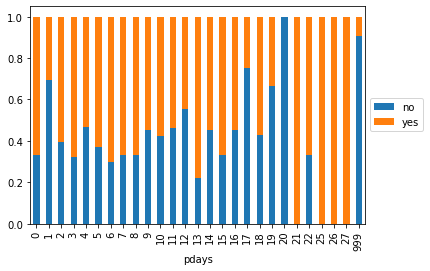

In [35]:
print(pd.crosstab(df['pdays'], df['y'], normalize='index'))

ct = pd.crosstab(df.pdays, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation : The success rate is pretty high if the client was last contacted from a previous campaign as opposed to the fact if he/she wasn't.

y               no       yes
previous                    
0         0.911678  0.088322
1         0.787985  0.212015
2         0.535809  0.464191
3         0.407407  0.592593
4         0.457143  0.542857
5         0.277778  0.722222
6         0.400000  0.600000
7         1.000000  0.000000


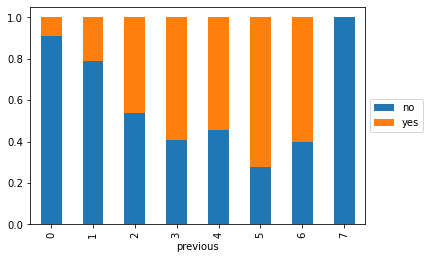

In [36]:
print(pd.crosstab(df['previous'], df['y'], normalize='index'))

ct = pd.crosstab(df.previous, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation :  The conversion rate is pretty good if just 3-6 calls were made to the customer in previous campaign.

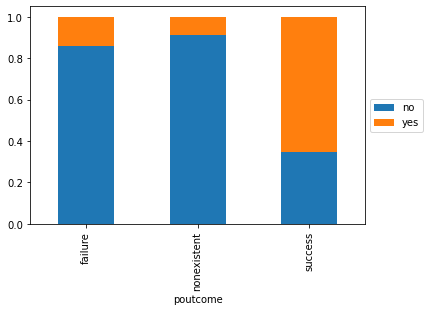

In [37]:
pd.crosstab(df['poutcome'], df['y'], normalize='index')

ct = pd.crosstab(df.poutcome, df.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: Very High chances of positive conversion if the customer subscribed in the previous campaign.

In [38]:
#To Check how numberical columns are correlated with target values. Converting the target column to a numerical one.
labelencoder_X=LabelEncoder()
df.y=labelencoder_X.fit_transform(df.y)
corelation=df.corr()

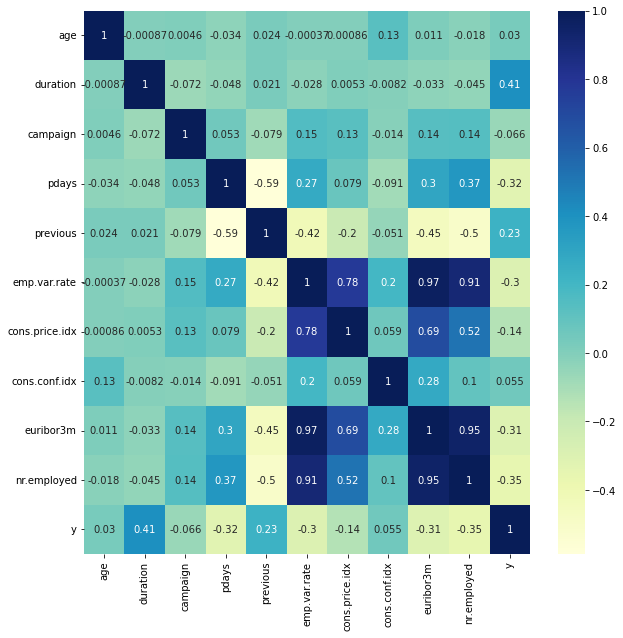

In [39]:
plt.figure(figsize=(10,10))
a=sns.heatmap(corelation,annot=True,cmap="YlGnBu")

#### Observation: There is a high positive correlation of Target value with Duration and the previous outcome. All the socio-economic factors are highly correlated to each other.

## How Economic Cycle Affects Term Deposit

In [40]:
fig4 = px.scatter(data_frame=df, x='age', y='euribor3m', color='y')
fig4.show()

#### Obersvation: It seems that People are subscribing to term deposit when the 3Month Euribor rate is low specifically below 2. That means, when the unsecured loan lending rate is low at that time the returns on secured deposits are even lower. Since consumers do not get better return on other government backed deposits, they are likely to subscribe to special term deposits offered by banks.

<class 'pandas.core.frame.DataFrame'>


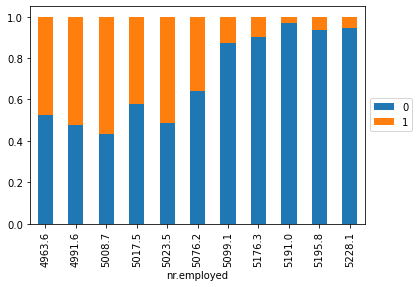

In [41]:
pd.crosstab(df['nr.employed'], df['y'], normalize='index')

ct = pd.crosstab(df['nr.employed'], df.y,normalize='index')
print(type(ct))
ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

# fig2 = px.bar(data_frame=ct, x='nr.employed', color='y')

In [42]:
fig4 = px.scatter(data_frame=df, x='euribor3m', y='nr.employed', color='y')
fig4.show()

#### Observation: When the economic cycle of the country is in expansion stage or at peak, then employment increases, that means that euribor is at high too which leads to low subscription of term deposit and vice-versa

# Data Preparation

In [43]:
df= pd.read_csv(r"bank-additional-full.csv",sep=';')

In [44]:
df

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,...,2,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes


In [45]:
# Target Dataframe

outcome = df.iloc[:,-1]
outcome

0         no
1         no
2         no
3         no
4         no
        ... 
41183    yes
41184     no
41185     no
41186    yes
41187     no
Name: y, Length: 41188, dtype: object

In [46]:
#Converting the Target 'yes' and 'no' to numerical 1 and 0

y = outcome.map({'yes': 1, 'no': 0})
y

0        0
1        0
2        0
3        0
4        0
        ..
41183    1
41184    0
41185    0
41186    1
41187    0
Name: y, Length: 41188, dtype: int64

In [47]:
# Creating Dataframe sans the target value.
X = df.iloc[:, :-1]
X

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,261,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,149,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
2,37,services,married,high.school,no,yes,no,telephone,may,mon,226,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,151,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
4,56,services,married,high.school,no,no,yes,telephone,may,mon,307,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,334,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,383,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,189,2,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,442,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6


In [48]:
# Using the one-hot encoding method to convert the categorical values to Numerical ones

X = pd.get_dummies(X)

In [49]:
X

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,...,month_oct,month_sep,day_of_week_fri,day_of_week_mon,day_of_week_thu,day_of_week_tue,day_of_week_wed,poutcome_failure,poutcome_nonexistent,poutcome_success
0,56,261,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
1,57,149,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
2,37,226,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
3,40,151,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
4,56,307,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,334,1,999,0,-1.1,94.767,-50.8,1.028,4963.6,...,0,0,1,0,0,0,0,0,1,0
41184,46,383,1,999,0,-1.1,94.767,-50.8,1.028,4963.6,...,0,0,1,0,0,0,0,0,1,0
41185,56,189,2,999,0,-1.1,94.767,-50.8,1.028,4963.6,...,0,0,1,0,0,0,0,0,1,0
41186,44,442,1,999,0,-1.1,94.767,-50.8,1.028,4963.6,...,0,0,1,0,0,0,0,0,1,0


## Splitting and Scaling the Data 

Splitting the Data into Test-Train split. We are using Stratify parameter for splitting. This stratify parameter makes a split so that the proportion of values in the sample produced will be the same as the proportion of values provided to parameter stratify. 
Since y now is a binary categorical variable with values 0 and 1 and there are around 10% of ones and 90% of zeroes, stratify=y will make sure that our random split has 10% of ones and 90% of zeroes in both the splitted data points. This is done so as to make the test set representative of the actual population in unbalanced Dataset.



In [50]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0, stratify=y)


In [51]:
X_train.shape

(30891, 63)

In [52]:
X_test.shape

(10297, 63)

In [53]:
#Scaling the data using Standard Scaler before creating ML model

In [54]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_train_scaled

array([[-1.44619515, -0.58943909,  0.51767029, ...,  2.93197178,
        -2.50232614, -0.18618915],
       [ 1.73090883,  0.28361817, -0.20461304, ..., -0.3410674 ,
         0.39962816, -0.18618915],
       [-0.48343637,  1.08360015, -0.20461304, ..., -0.3410674 ,
         0.39962816, -0.18618915],
       ...,
       [-0.57971225,  0.02977773,  0.15652863, ..., -0.3410674 ,
         0.39962816, -0.18618915],
       [-1.06109164, -0.32790652, -0.56575471, ..., -0.3410674 ,
         0.39962816, -0.18618915],
       [ 3.46387464, -0.14329529, -0.56575471, ..., -0.3410674 ,
         0.39962816, -0.18618915]])

In [55]:
X_test_scaled = scaler.transform(X_test)
X_test_scaled

array([[-2.05697710e-03, -2.54831242e-01, -5.65754710e-01, ...,
        -3.41067403e-01,  3.99628164e-01, -1.86189148e-01],
       [-1.94608733e-01, -5.66362686e-01,  8.78811962e-01, ...,
        -3.41067403e-01,  3.99628164e-01, -1.86189148e-01],
       [ 2.86770657e-01, -1.89448100e-01,  1.56528626e-01, ...,
        -3.41067403e-01,  3.99628164e-01, -1.86189148e-01],
       ...,
       [-3.87160490e-01,  2.64387831e-01, -5.65754710e-01, ...,
        -3.41067403e-01,  3.99628164e-01, -1.86189148e-01],
       [-1.44619515e+00,  1.04513947e+00,  1.60109530e+00, ...,
        -3.41067403e-01,  3.99628164e-01, -1.86189148e-01],
       [-7.72264002e-01,  3.99891909e+00, -5.65754710e-01, ...,
        -3.41067403e-01,  3.99628164e-01, -1.86189148e-01]])

## Modeling

We are using 5 Machine Learning Models and performing Hyperparameter Tuning on each of them to get the best Result. The models that we are going to use are:
    
1. Logistic Regression
2. Random Forest
3. KNN
4. Support Vector Machines
5. ADAboost 

### Scoring

The dataset is highly imbalanced. There are just 11% postive targets. Accuracy cannot be used as a metric for our ML model since a bad model which predicts all targets as negative will lead to an accuracy of 89% which shouldn't be the ideal case.

We would like to increase the True Positives and decrease both the False Positives and False Negatives.

For us both Precision and Recall are important, but we need to make a trade-off to get the best possible metric for our scenario.

#### Scenario -1 

False Negatives - The customer was destined to subscribe term deposit but the Model predicted that the customer won't subscribe

#### Scenario- 2

False Positives - The customer wasn't destined to subscribe term deposit but the Model predicted that the customer would subscribe.

#### Conclusion


According to us Scenario 1 has much more weight as compared to Scenario 2. The ratio of successful term deposit is already very less as seen from the current dataset. We cannot let go of a prospective customer by putting less efforts just because our model predicted that the customer won't subscribe. 

This means we will be using a metric that places higher weight to Recall or reducing the False negatives. Hence, we are using F-beta score with beta as 2 that will suffice our requirement.

### Logistic Regression

Used GridSearchCV for Hyperparameter tuning on the Logistic Regression model. Parameters chosen:
- cv - Determines the cross-validation splitting strategy. 
- scoring - Strategy to evaluate the performance of the cross-validated model on the test set(f2 in our case)
- C - Inverse of Regularization Strength
- class_weight - Since the data is more biased towards the 'No' targets we will also try to tune the model using the class weight parameter. The model will penalizes mistakes in samples of 'Yes' with a higher class weight instead of 1. So higher class-weight means we want to put more emphasis on 'Yes'. 

In [56]:
f2_score = make_scorer(fbeta_score, beta=2, pos_label=1)

lr = GridSearchCV(LogisticRegression(random_state=0), param_grid={'C':[10**x for x in range(-4,5)], 
                                                   "class_weight":['balanced', {1:10, 0:1},
                                                                  {1:5, 0:1}, 
                                                                  {1:2, 0:1}]}, cv=4, scoring= f2_score)

In [57]:
# Fititng the training data
lr.fit(X_train_scaled, y_train)

GridSearchCV(cv=4, estimator=LogisticRegression(random_state=0),
             param_grid={'C': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000,
                               10000],
                         'class_weight': ['balanced', {0: 1, 1: 10},
                                          {0: 1, 1: 5}, {0: 1, 1: 2}]},
             scoring=make_scorer(fbeta_score, beta=2, pos_label=1))

In [58]:
#Mean cross-validated score of the best_estimator and the best parameters 

lr.best_score_, lr.best_params_

(0.7359984436990192, {'C': 1, 'class_weight': {1: 10, 0: 1}})

In [59]:
#f2 score of the model on test data

lr.score(X_test_scaled, y_test)

0.7406630297943768

In [60]:
lrprediction = lr.predict(X_test_scaled)
lrprediction

array([1, 0, 0, ..., 0, 0, 1], dtype=int64)

In [61]:
lrprediction

array([1, 0, 0, ..., 0, 0, 1], dtype=int64)

In [62]:
#Confusion Matrix

print("Confusion Matrix:")
print(confusion_matrix(y_test, lrprediction))


Confusion Matrix:
[[7687 1450]
 [ 101 1059]]


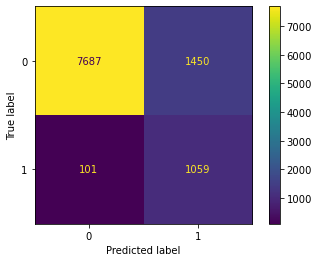

In [63]:
plot_confusion_matrix(lr,
                      X_test_scaled,
                      y_test,
                      values_format='d')
plt.grid(False)


### Random Forest

Used GridSearchCV for Hyperparameter tuning on the Random Forest model. Parameters chosen:
- cv - Determines the cross-validation splitting strategy.
- scoring - Strategy to evaluate the performance of the cross-validated model on the test set(f2 in our case).
- class_weight - Since the data is more biased towards the 'No' targets, we will also try to tune the model using the class weight parameter. The model will penalizes mistakes in samples of 'Yes' with a higher class weight instead of 1. So higher class-weight means we want to put more emphasis on 'Yes'.
- n_estimators - the number of trees we want to build before taking the maximum voting or averages of predictions.
- max_depth - This determines the maximum depth of the tree

In [64]:

rf = GridSearchCV(RandomForestClassifier(random_state=0), param_grid={'n_estimators':[10, 50, 100, 200], 'max_depth':[2,4,6,8],
                                                   "class_weight":['balanced', {'yes':10, 'no':1},
                                                                  {'yes':5, 'no':1}, 
                                                                  {'yes':2, 'no':1}]}, cv=3, scoring=f2_score)

In [65]:
rf.fit(X_train_scaled, y_train)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 331, in fit
    y, expanded_class_weight = self._validate_y_class_weight(y)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 604, in _validate_y_class_weight
    expanded_class_weight = compute_sample_weight(class_weight,
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\class_weight.py", line 165, in compu

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 331, in fit
    y, expanded_class_weight = self._validate_y_class_weight(y)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 604, in _validate_y_class_weight
    expanded_class_weight = compute_sample_weight(class_weight,
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\class_weight.py", line 165, in compu

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 331, in fit
    y, expanded_class_weight = self._validate_y_class_weight(y)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 604, in _validate_y_class_weight
    expanded_class_weight = compute_sample_weight(class_weight,
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\class_weight.py", line 165, in compu

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 331, in fit
    y, expanded_class_weight = self._validate_y_class_weight(y)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 604, in _validate_y_class_weight
    expanded_class_weight = compute_sample_weight(class_weight,
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\class_weight.py", line 165, in compu

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 331, in fit
    y, expanded_class_weight = self._validate_y_class_weight(y)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 604, in _validate_y_class_weight
    expanded_class_weight = compute_sample_weight(class_weight,
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\class_weight.py", line 165, in compu

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 331, in fit
    y, expanded_class_weight = self._validate_y_class_weight(y)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 604, in _validate_y_class_weight
    expanded_class_weight = compute_sample_weight(class_weight,
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\class_weight.py", line 165, in compu

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 331, in fit
    y, expanded_class_weight = self._validate_y_class_weight(y)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 604, in _validate_y_class_weight
    expanded_class_weight = compute_sample_weight(class_weight,
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\class_weight.py", line 165, in compu

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning:

Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 331, in fit
    y, expanded_class_weight = self._validate_y_class_weight(y)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py", line 604, in _validate_y_class_weight
    expanded_class_weight = compute_sample_weight(class_weight,
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\class_weight.py", line 165, in compu

GridSearchCV(cv=3, estimator=RandomForestClassifier(random_state=0),
             param_grid={'class_weight': ['balanced', {'no': 1, 'yes': 10},
                                          {'no': 1, 'yes': 5},
                                          {'no': 1, 'yes': 2}],
                         'max_depth': [2, 4, 6, 8],
                         'n_estimators': [10, 50, 100, 200]},
             scoring=make_scorer(fbeta_score, beta=2, pos_label=1))

In [66]:
#Mean cross-validated score of the best_estimator and the best parameters 

rf.best_score_, rf.best_params_

(0.7352847905417864,
 {'class_weight': 'balanced', 'max_depth': 8, 'n_estimators': 50})

In [67]:
#f2 score of the model on test data

rf.score(X_test_scaled, y_test)

0.7437387574373877

In [68]:
rfprediction = rf.predict(X_test_scaled)
rfprediction

array([1, 0, 0, ..., 1, 0, 1], dtype=int64)

In [69]:
#Confusion Matrix

print("Confusion Matrix:")
print(confusion_matrix(y_test, rfprediction))

Confusion Matrix:
[[7625 1512]
 [  85 1075]]


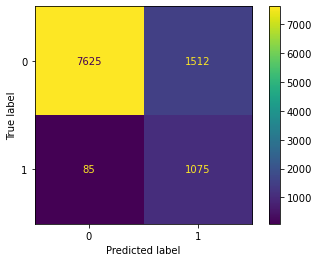

In [70]:
plot_confusion_matrix(rf,
                      X_test_scaled,
                      y_test,
                      values_format='d')
plt.grid(False)


### KNN 

Used GridSearchCV for Hyperparameter tuning on the KNN model. Parameters chosen:
- cv - Determines the cross-validation splitting strategy.
- scoring - Strategy to evaluate the performance of the cross-validated model on the test set(f2 in our case).
- n_neighbours - Number of neighbors to use by default for kneighbors queries.
- n_jobs - The number of parallel jobs to run for neighbors search.

In [71]:
knn = GridSearchCV(KNeighborsClassifier(), param_grid={'n_neighbors':[x for x in range(3, 17, 2)]}, n_jobs=3, cv=4, scoring=f2_score)

In [72]:
knn.fit(X_train_scaled, y_train)

GridSearchCV(cv=4, estimator=KNeighborsClassifier(), n_jobs=3,
             param_grid={'n_neighbors': [3, 5, 7, 9, 11, 13, 15]},
             scoring=make_scorer(fbeta_score, beta=2, pos_label=1))

In [73]:
#Mean cross-validated score of the best_estimator and the best parameters 

knn.best_score_, knn.best_params_

(0.3623029370364513, {'n_neighbors': 3})

In [74]:
#f2 score of the model on test data

knn.score(X_test_scaled, y_test)

0.34476332463660087

In [75]:
knnprediction = knn.predict(X_test_scaled)
knnprediction

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [76]:
#Confusion Matrix

print("Confusion Matrix:")
print(confusion_matrix(y_test, knnprediction))


Confusion Matrix:
[[8781  356]
 [ 790  370]]


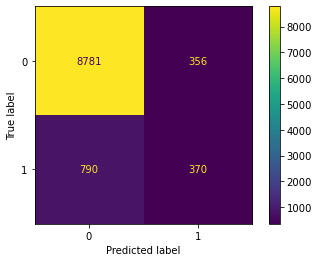

In [77]:
plot_confusion_matrix(knn,
                      X_test_scaled,
                      y_test,
                      values_format='d')
plt.grid(False)


## Support Vector Machines(SVM)

Used GridSearchCV for Hyperparameter tuning on the SVM model. Parameters chosen:
- cv - Determines the cross-validation splitting strategy. 
- scoring - Strategy to evaluate the performance of the cross-validated model on the test set(f2 in our case).
- C - Inverse of Regularization Strength
- gamma - defines how far the influence of a single training example reaches, with low values meaning 'far' and high values meaning 'close'.
- kernel - a method used to take data as input and transform into the required form of processing data.
- class_weight - Since the data is more biased towards the 'No' targets, we will also try to tune the model using the class weight parameter. The model will penalizes mistakes in samples of 'Yes' with a higher class weight instead of 1. So higher class-weight means we want to put more emphasis on 'Yes'. 

In [78]:
f2_score = make_scorer(fbeta_score, beta=2, pos_label=1)

In [79]:
#Used Grid Search to find best score and parameters for inputs. However, since SVM takes approx 5 hours to run 
#below code completely, we will be keeping the best params for you to run in next cell. Feel free to run the below commented code
# if you want! BEWARE! it will take 5 hours approx to run!

# param_grid = [
#     {'C': [10, 100, 1000, 10000],
#      'gamma': ['scale', 0.001, 0.0001, 0.00001],
#      'kernel': ['rbf'],
#      "class_weight":['balanced', {1:10, 0:1}, {1:5, 0:1}, {1:2, 0:1}]}
# ]

# from sklearn.model_selection import GridSearchCV
# optimal_params = GridSearchCV(
#     SVC(),
#     param_grid,
#     cv=5,
#     scoring=f2_score,
#     verbose=0
# )

# optimal_params.fit(X_train_scaled, y_train)

# print(optimal_params.best_params_)

# {'C': 10000, 'class_weight': {1: 10, 0: 1}, 'gamma': 1e-05, 'kernel': 'rbf'} - Best parameters received 
#after running the code for 5 hours.

In [80]:
# Since we already ran the code once and we know the best params, so we are just keeping the best params only to 
# complete the notebook.

param_grid = [
    {'C': [10000],
     'gamma': [0.00001],
     'kernel': ['rbf'],
     "class_weight":[{1:10, 0:1}]}
]

optimal_params = GridSearchCV(
    SVC(random_state=0),
    param_grid,
    cv=5,
    scoring=f2_score,
    verbose=0
)

optimal_params.fit(X_train_scaled, y_train)

print(optimal_params.best_params_)

{'C': 10000, 'class_weight': {1: 10, 0: 1}, 'gamma': 1e-05, 'kernel': 'rbf'}


In [81]:
#Mean cross-validated score of the best_estimator and the best parameters 

optimal_params.best_score_, optimal_params.best_params_
# (0.7410119617636571,
#  {'C': 10000, 'class_weight': {1: 10, 0: 1}, 'gamma': 1e-05, 'kernel': 'rbf'})

(0.7410119617636571,
 {'C': 10000, 'class_weight': {1: 10, 0: 1}, 'gamma': 1e-05, 'kernel': 'rbf'})

In [82]:
#f2 score of the model on test data

optimal_params.score(X_test_scaled, y_test)


0.7446663019693655

In [83]:
svm_prediction = optimal_params.predict(X_test_scaled)
svm_prediction

array([1, 0, 0, ..., 1, 0, 1], dtype=int64)

In [84]:
#Confusion Matrix

print("Confusion Matrix:")
print(confusion_matrix(y_test, svm_prediction))

Confusion Matrix:
[[7554 1583]
 [  71 1089]]


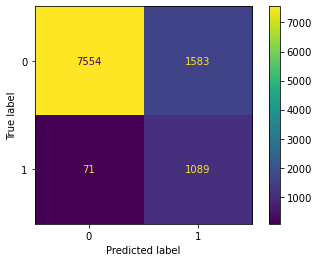

In [85]:
plot_confusion_matrix(optimal_params,
                      X_test_scaled,
                      y_test,
                      values_format='d')
plt.grid(False)


# Adaboost Classification

Used GridSearchCV for Hyperparameter tuning on the SVM model. Parameters chosen:
- cv - Determines the cross-validation splitting strategy. 
- scoring - Strategy to evaluate the performance of the cross-validated model on the test set(f2 in our case).
- Base estimator - Decision Tree
- n_estimators - The number of base estimators or weak learners we want to use in our dataset.
- learning_rate - This parameter is provided to shrink the contribution of each classifier.
- algorithm - The performance of the SAMME and SAMME.R algorithms are compared. SAMME.R uses the probability estimates to update the additive model, while SAMME uses the classifications only.


In [86]:
kfold = StratifiedKFold(n_splits=10)
param_grid = {'base_estimator__criterion':['gini','entropy'],
           'base_estimator__splitter':['best','random'],
           'algorithm':['SAMME','SAMME.R'],
           'n_estimators':[1,2,3,10,100,200, 300],
           'learning_rate':[0.01,0.1,0.5,1,1.3]}

DTC = DecisionTreeClassifier(random_state = 0)

ABC = AdaBoostClassifier(base_estimator = DTC, random_state = 0)

# run grid search
grid_search_ABC = GridSearchCV(ABC, param_grid=param_grid, scoring = f2_score, cv=kfold)

In [87]:
grid_search_ABC.fit(X_train_scaled, y_train)

GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=False),
             estimator=AdaBoostClassifier(base_estimator=DecisionTreeClassifier(random_state=0),
                                          random_state=0),
             param_grid={'algorithm': ['SAMME', 'SAMME.R'],
                         'base_estimator__criterion': ['gini', 'entropy'],
                         'base_estimator__splitter': ['best', 'random'],
                         'learning_rate': [0.01, 0.1, 0.5, 1, 1.3],
                         'n_estimators': [1, 2, 3, 10, 100, 200, 300]},
             scoring=make_scorer(fbeta_score, beta=2, pos_label=1))

In [88]:
#Mean cross-validated score of the best_estimator and the best parameters 

grid_search_ABC.best_score_, grid_search_ABC.best_params_

(0.5266062729624816,
 {'algorithm': 'SAMME',
  'base_estimator__criterion': 'entropy',
  'base_estimator__splitter': 'best',
  'learning_rate': 0.01,
  'n_estimators': 1})

In [89]:
#f2 score of the model on test data
grid_search_ABC.score(X_test_scaled, y_test)

0.5099759201926385

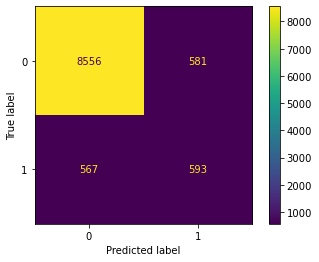

In [90]:
plot_confusion_matrix(grid_search_ABC,
                      X_test_scaled,
                      y_test,
                      values_format='d')
# Hide grid lines
plt.grid(False)


### Comparing F2-Scores obtained from different models.
1. Logistic Regression -          0.740
2. Random Forest Classification - 0.743
3. KNearest Neighbours -          0.344
4. Support Vector Machines -      0.744
5. AdaBoost Classification -      0.509

#### Best score comes from SVM and also when looking at the confusion matrix, the False Negatives were the lowest in the same which was our main target. If False Negatives are low that means just spending the resources on True Positives and False Positives, company will have a higher net profit. Also, company will lose less number of clients who were going to subscribe the term deposit.

# Clustering

Now we will try to cluster the data so as to find in any relationship that maximizes the positive conversion rate of term deposit.

### KMeans Clustering

In [91]:
df

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,...,2,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes


In [92]:
#Removing the Target Value from the dataframe which will be introduced later after the clustering is done

X = df.iloc[:, :-1]
X

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,261,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,149,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
2,37,services,married,high.school,no,yes,no,telephone,may,mon,226,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,151,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
4,56,services,married,high.school,no,no,yes,telephone,may,mon,307,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,334,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,383,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,189,2,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,442,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6


In [93]:
#Using one-hot encoding to convert categorical value to numeric

X = pd.get_dummies(X)
X

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,...,month_oct,month_sep,day_of_week_fri,day_of_week_mon,day_of_week_thu,day_of_week_tue,day_of_week_wed,poutcome_failure,poutcome_nonexistent,poutcome_success
0,56,261,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
1,57,149,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
2,37,226,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
3,40,151,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
4,56,307,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,334,1,999,0,-1.1,94.767,-50.8,1.028,4963.6,...,0,0,1,0,0,0,0,0,1,0
41184,46,383,1,999,0,-1.1,94.767,-50.8,1.028,4963.6,...,0,0,1,0,0,0,0,0,1,0
41185,56,189,2,999,0,-1.1,94.767,-50.8,1.028,4963.6,...,0,0,1,0,0,0,0,0,1,0
41186,44,442,1,999,0,-1.1,94.767,-50.8,1.028,4963.6,...,0,0,1,0,0,0,0,0,1,0


In [94]:
#Scaling the dataframe using Standard Scaler

scaler1 = StandardScaler()
X_scaled = scaler1.fit_transform(X)

In [95]:
X_scaled

array([[ 1.53303429,  0.01047142, -0.56592197, ..., -0.3392905 ,
         0.39770593, -0.1857    ],
       [ 1.62899323, -0.42150051, -0.56592197, ..., -0.3392905 ,
         0.39770593, -0.1857    ],
       [-0.29018564, -0.12451981, -0.56592197, ..., -0.3392905 ,
         0.39770593, -0.1857    ],
       ...,
       [ 1.53303429, -0.26722482, -0.20490853, ..., -0.3392905 ,
         0.39770593, -0.1857    ],
       [ 0.38152696,  0.70856893, -0.56592197, ..., -0.3392905 ,
         0.39770593, -0.1857    ],
       [ 3.26029527, -0.07438021,  0.15610492, ...,  2.94732687,
        -2.51442063, -0.1857    ]])

In [96]:
ssd = []

for k in range(2,10):
    
    model = KMeans(n_clusters=k, random_state=10, n_init = 20)
    
    
    model.fit(X_scaled)
    
    #Sum of squared distances of samples to their closest cluster center.
    ssd.append(model.inertia_)

Text(0, 0.5, ' Sum of Squared Distances')

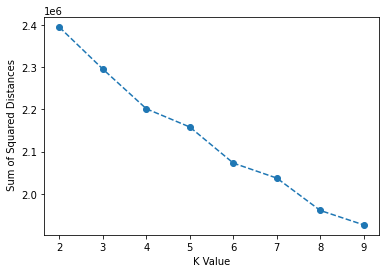

In [97]:
#Plot between the K Value and Sum of Squared Distances 

plt.plot(range(2,10),ssd,'o--')
plt.xlabel("K Value")
plt.ylabel(" Sum of Squared Distances")

### Observation: An Elbow is seen around when the K-Value is around 5. We will try to cluster the data into 5 different Clusters.


In [98]:
#Predicting the clusters for the data points

model = KMeans(n_clusters=5, random_state=10, n_init = 20)
cluster_labels = model.fit_predict(X_scaled)
cluster_labels

array([4, 2, 4, ..., 3, 3, 3])

In [99]:
#Adding the obtained clusters to the original dataframe as a new column

dfcl = df
dfcl['Cluster'] = cluster_labels
dfcl

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,Cluster
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,4
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,2
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,4
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,4
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes,3
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,...,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no,3
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,...,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no,3
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,...,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes,3


In [100]:
#Using PCA to visualize the clusters formed in a 3D Space


pca = PCA(n_components=3)
components = pca.fit_transform(X_scaled)

fig = px.scatter_3d(components, x=0, y=1, z=2, color=cluster_labels)
fig.show()

#### Observation: The clusters are well separated from each other in the 3D space

### Analysis of of Clusters obtained through KMeans

y              no       yes
Cluster                    
0        0.362558  0.637442
1        0.940895  0.059105
2        0.956675  0.043325
3        0.813353  0.186647
4        0.958360  0.041640


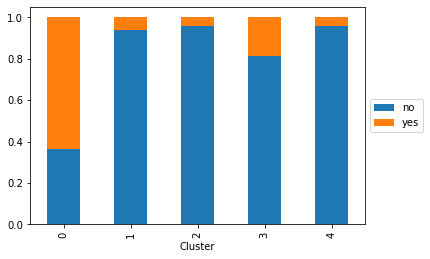

In [101]:
U = pd.crosstab(dfcl['Cluster'], dfcl['y'], normalize='index')
print(U)

ct = pd.crosstab(dfcl.Cluster, dfcl.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: For the Cluster 0 the conversion rate is very high(64%) as compared to others. Cluster 2 has the least conversion rate.

In [102]:
#Finding the data points that form the 0 Cluster
X0 = dfcl.loc[dfcl['Cluster'] == 0]
X0

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,Cluster
24108,37,admin.,married,university.degree,no,yes,no,telephone,nov,wed,...,6,1,success,-0.1,93.200,-42.0,4.286,5195.8,no,0
24264,48,management,married,university.degree,no,yes,no,cellular,nov,mon,...,4,1,success,-0.1,93.200,-42.0,4.191,5195.8,no,0
24279,42,technician,married,professional.course,unknown,yes,no,cellular,nov,mon,...,4,1,success,-0.1,93.200,-42.0,4.191,5195.8,no,0
24397,50,entrepreneur,married,university.degree,unknown,yes,no,cellular,nov,mon,...,3,1,success,-0.1,93.200,-42.0,4.191,5195.8,no,0
24482,36,self-employed,single,university.degree,no,yes,no,cellular,nov,mon,...,4,1,success,-0.1,93.200,-42.0,4.191,5195.8,no,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41163,35,technician,divorced,basic.4y,no,yes,no,cellular,nov,tue,...,4,2,success,-1.1,94.767,-50.8,1.035,4963.6,yes,0
41164,54,admin.,married,professional.course,no,no,no,cellular,nov,tue,...,10,1,success,-1.1,94.767,-50.8,1.035,4963.6,yes,0
41174,62,retired,married,university.degree,no,yes,no,cellular,nov,thu,...,1,6,success,-1.1,94.767,-50.8,1.031,4963.6,yes,0
41178,62,retired,married,university.degree,no,no,no,cellular,nov,thu,...,6,3,success,-1.1,94.767,-50.8,1.031,4963.6,yes,0


In [103]:
df.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,Cluster
count,41188.00000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000
mean,40.02406,258.285010,2.567593,962.475454,0.172963,0.081886,93.575664,-40.502600,3.621291,5167.035911,2.440080
std,10.42125,259.279249,2.770014,186.910907,0.494901,1.570960,0.578840,4.628198,1.734447,72.251528,1.198723
min,17.00000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000,0.000000
25%,32.00000,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000,1.000000
50%,38.00000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000,3.000000
75%,47.00000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000,3.000000
max,98.00000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000,4.000000


In [104]:
X0.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,Cluster
count,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.000000,1517.0
mean,41.848385,321.363217,1.822017,7.323665,1.665788,-2.095320,93.343523,-38.340804,0.985823,5029.176599,0.0
std,15.289621,254.536063,1.240783,36.245190,0.944207,0.832937,0.783205,6.624061,0.533281,52.310543,0.0
min,17.000000,1.000000,1.000000,0.000000,1.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000,0.0
25%,30.000000,165.000000,1.000000,3.000000,1.000000,-2.900000,92.649000,-42.000000,0.718000,4991.600000,0.0
50%,37.000000,253.000000,1.000000,6.000000,1.000000,-1.800000,93.200000,-38.300000,0.879000,5017.500000,0.0
75%,52.000000,392.000000,2.000000,7.000000,2.000000,-1.700000,94.055000,-31.400000,1.044000,5076.200000,0.0
max,98.000000,3509.000000,13.000000,999.000000,7.000000,-0.100000,94.767000,-26.900000,4.286000,5195.800000,0.0


#### Observation: If we compare the cluster and the main dataframe we see that highly successful cluster has higher mean age, higher mean duration of call.

<AxesSubplot:xlabel='poutcome', ylabel='count'>

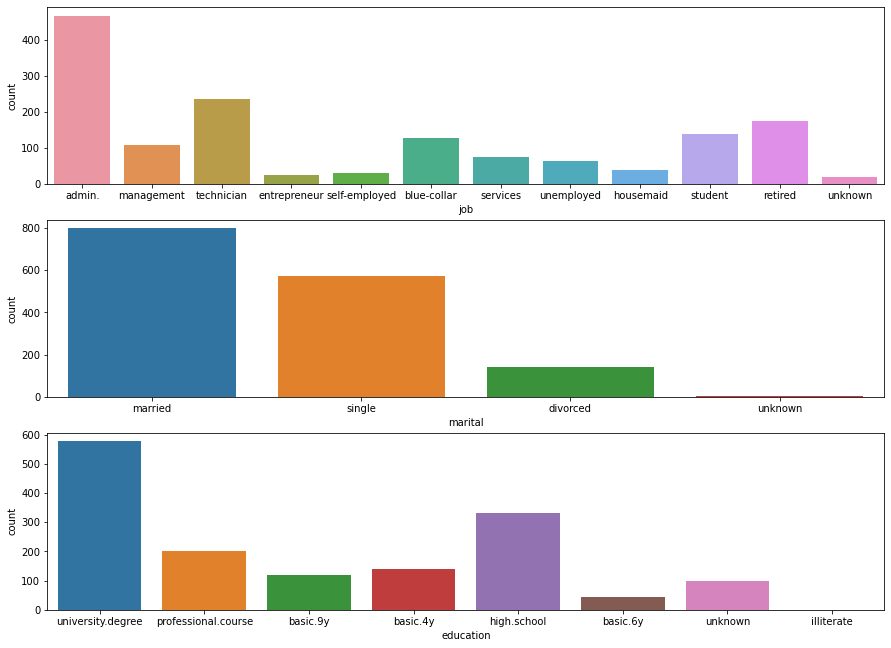

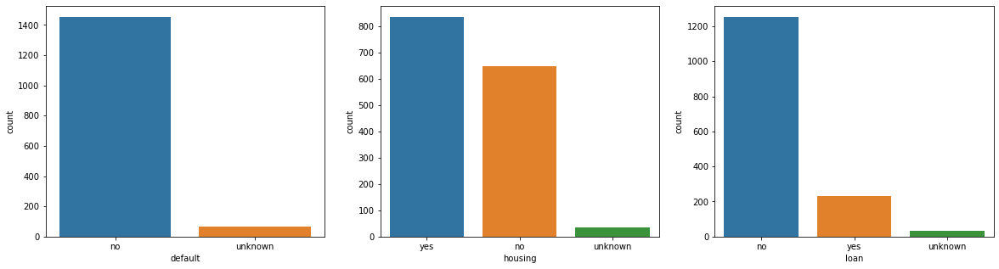

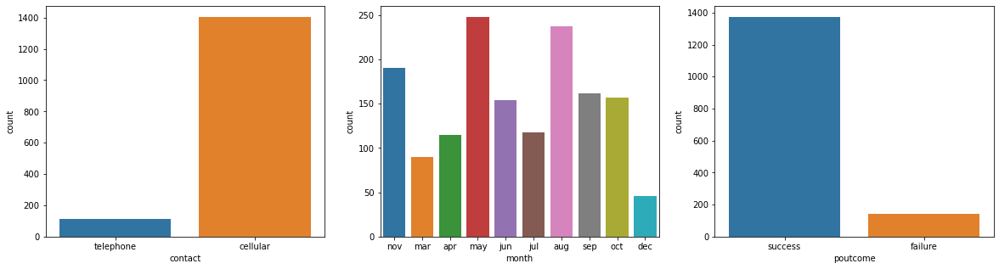

In [105]:
plt.figure(figsize=(15,15))
plt.subplot(4,1,1)
sns.countplot(X0['job'])
plt.subplot(4,1,2)
sns.countplot(X0['marital'])
plt.subplot(4,1,3)
sns.countplot(X0['education'])
fig, (ax1, ax2, ax3) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'default', data = X0, ax = ax1)
sns.countplot(x = 'housing', data = X0, ax = ax2)
sns.countplot(x = 'loan', data = X0, ax = ax3)
fig2, (ax4, ax5, ax6) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'contact', data = X0, ax = ax4)
sns.countplot(x = 'month', data = X0, ax = ax5)
sns.countplot(x = 'poutcome', data = X0, ax = ax6)

The the various countplots obtained in this cluster are mostly in accordance with countplot of the entire dataset. Few exceptions are there.

There cluster doesn't have any datapoint with credit in default.

The cellular mode of contact is very high as compared to telephone.

In [106]:
fig = px.scatter(X0, x="campaign", y="duration", color="y")
fig.show()

#### Observation : The above scatter plot for this cluster shows that the customers who were contacted less subscribed to the Term deposit more than the ones who got higher frequency of calls. The higher duration of calls also leads to a higher chance of subscribing the term deposit, which is indicative of whole dataset as well.

y                    no       yes
job                              
admin.         0.345416  0.654584
blue-collar    0.503876  0.496124
entrepreneur   0.576923  0.423077
housemaid      0.292683  0.707317
management     0.351852  0.648148
retired        0.285714  0.714286
self-employed  0.437500  0.562500
services       0.381579  0.618421
student        0.321429  0.678571
technician     0.360169  0.639831
unemployed     0.338462  0.661538
unknown        0.650000  0.350000


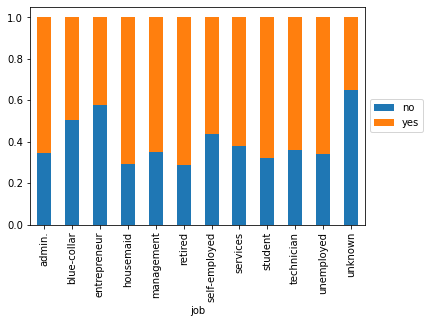

In [107]:
print(pd.crosstab(X0['job'], X0['y'], normalize='index'))

ct = pd.crosstab(X0.job, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


#### The conversion rate in this cluster is less for blue-collar and enterpreneur which is indicative of the whole dataset as well

y               no       yes
previous                    
1         0.403468  0.596532
2         0.306173  0.693827
3         0.283133  0.716867
4         0.396552  0.603448
5         0.235294  0.764706
6         0.400000  0.600000
7         1.000000  0.000000


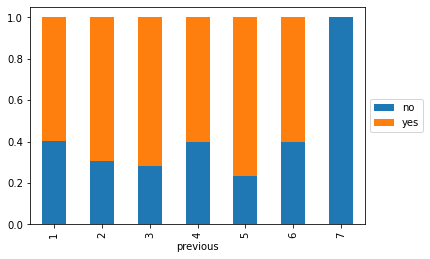

In [108]:
print(pd.crosstab(X0['previous'], X0['y'], normalize='index'))

ct = pd.crosstab(X0.previous, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation :  The conversion rate is pretty good if less than 7 calls were made to the customer before this campaign for this cluster. 

y              no       yes
default                    
no       0.355127  0.644873
unknown  0.531250  0.468750


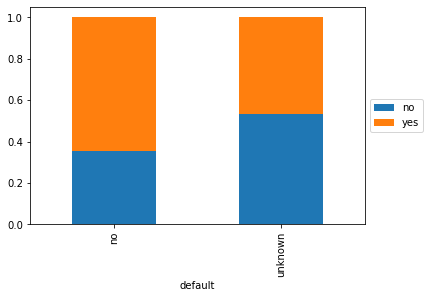

In [109]:
print(pd.crosstab(X0['default'], X0['y'], normalize='index'))

ct = pd.crosstab(X0.default, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: People without credit to their name are much likely to subscribe the term deposit which is indicated in the complete dataset as well.

y               no       yes
marital                     
divorced  0.297872  0.702128
married   0.360902  0.639098
single    0.380454  0.619546
unknown   0.400000  0.600000


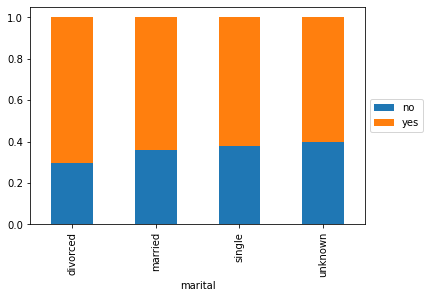

In [110]:
print(pd.crosstab(X0['marital'], X0['y'], normalize='index'))

ct = pd.crosstab(X0.marital, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: Marital status does not influence the term deposit subscription which is indicated in complete dataset as well

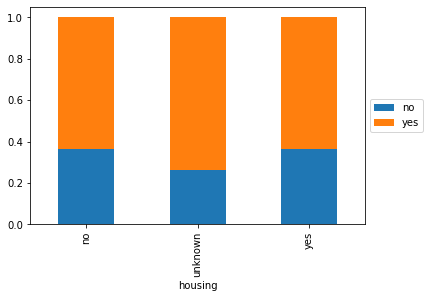

In [111]:
pd.crosstab(X0['housing'], X0['y'], normalize='index')

ct = pd.crosstab(X0.housing, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: Having a Housing loan doesn't influence the term deposit subscription much

y                no       yes
contact                      
cellular   0.361823  0.638177
telephone  0.371681  0.628319


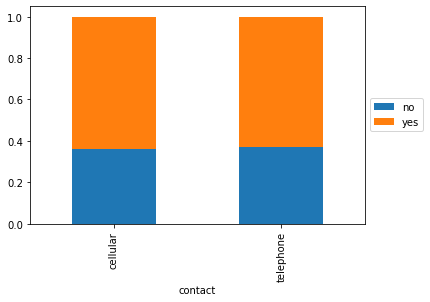

In [112]:
print(pd.crosstab(X0['contact'], X0['y'], normalize='index'))

ct = pd.crosstab(X0.contact, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Can't really differentiate the cluster on the basis of cellular or telephone mode.

y            no       yes
month                    
apr    0.391304  0.608696
aug    0.354430  0.645570
dec    0.326087  0.673913
jul    0.245763  0.754237
jun    0.337662  0.662338
mar    0.233333  0.766667
may    0.516129  0.483871
nov    0.426316  0.573684
oct    0.343949  0.656051
sep    0.253086  0.746914


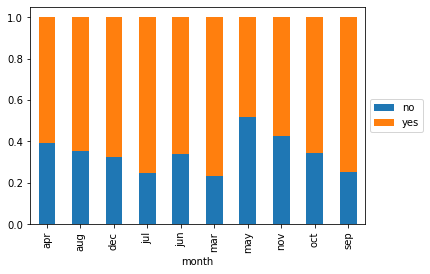

In [113]:
print(pd.crosstab(X0['month'], X0['y'], normalize='index'))

ct = pd.crosstab(X0.month, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Higher conversion is similar to the months of highest conversion in complete dataset with an exception of high conversion rate in July

y               no       yes
campaign                    
1         0.334586  0.665414
2         0.371622  0.628378
3         0.324841  0.675159
4         0.471698  0.528302
5         0.642857  0.357143
6         0.450000  0.550000
7         0.777778  0.222222
8         1.000000  0.000000
11        1.000000  0.000000
13        1.000000  0.000000


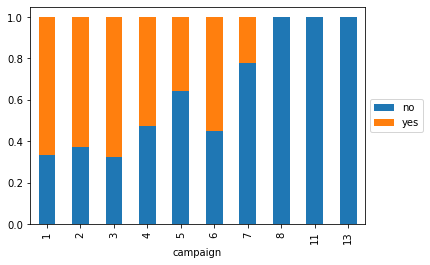

In [114]:
print(pd.crosstab(X0['campaign'], X0['y'], normalize='index'))

ct = pd.crosstab(X0.campaign, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation : The above plot for this cluster shows that the customers who were contacted less subscribed to the Term deposit more than the ones who got higher frequency of calls.

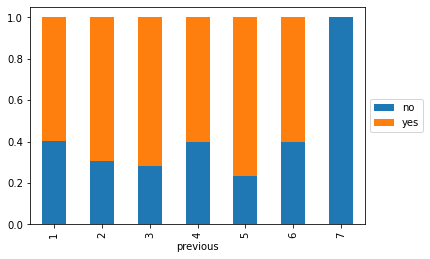

In [115]:
pd.crosstab(X0['previous'], X0['y'], normalize='index')

ct = pd.crosstab(X0.previous, X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation: Less number of calls lead  to a customer subscribing  the term deposit which is indicated in the complete dataset as well.

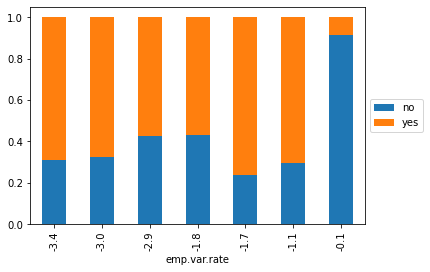

In [116]:
pd.crosstab(X0['emp.var.rate'], X0['y'], normalize='index')

ct = pd.crosstab(X0['emp.var.rate'], X0.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

#### Observation:  The lower the emp.var.rate better chances of conversion of term deposit

## DBScan

Finding clusters using DB scan technique

In [117]:
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_scaled)
distances, indices = nbrs.kneighbors(X_scaled)
# print(distances)

# next, we sort and plot the results
distances = np.sort(distances, axis=0)
distances = distances[:,1]
# print(distances)

In [118]:
fig = px.scatter(
    distances, 
    title='Distance Curve')
fig.update_xaxes(title_text='Distances')
fig.update_yaxes(title_text='Distance threashold (espsilon)')
fig.show()

In [119]:
# max eps looks like 10.6
# Compute DBSCAN


db = DBSCAN(eps=5.8, min_samples=8).fit(X_scaled)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)

print("Silhouette Coefficient: %0.3f"
      % silhouette_score(X_scaled, labels))

Estimated number of clusters: 33
Estimated number of noise points: 1965
Silhouette Coefficient: 0.105


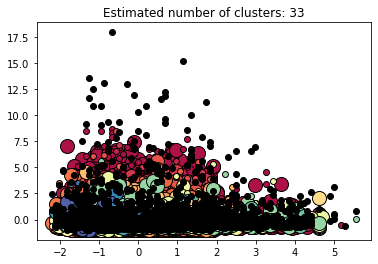

In [120]:
# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = X_scaled[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)

    xy = X_scaled[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()


In [121]:
dfcl = df

dfcl['Cluster']= labels

dfcl

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,Cluster
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,0
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes,1
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,...,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no,1
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,...,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no,1
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,...,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes,1


y              no       yes
Cluster                    
-1       0.620865  0.379135
 0       0.946652  0.053348
 1       0.923235  0.076765
 2       0.914710  0.085290
 3       0.921285  0.078715
 4       0.976744  0.023256
 5       0.929588  0.070412
 6       0.941353  0.058647
 7       0.789474  0.210526
 8       0.888889  0.111111
 9       0.489362  0.510638
 10      0.394881  0.605119
 11      0.416667  0.583333
 12      0.549153  0.450847
 13      0.464286  0.535714
 14      0.500000  0.500000
 15      0.375000  0.625000
 16      0.355556  0.644444
 17      0.666667  0.333333
 18      0.234043  0.765957
 19      0.638889  0.361111
 20      0.197368  0.802632
 21      0.700000  0.300000
 22      0.666667  0.333333
 23      0.388889  0.611111
 24      0.622137  0.377863
 25      0.437500  0.562500
 26      0.384615  0.615385
 27      0.461538  0.538462
 28      0.513514  0.486486
 29      0.666667  0.333333
 30      0.178571  0.821429
 31      0.192308  0.807692
 32      0.500000  0

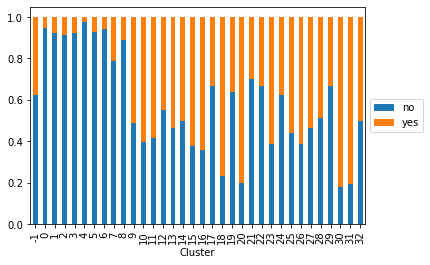

In [122]:
U = pd.crosstab(dfcl['Cluster'], dfcl['y'], normalize='index')
print(U)
ct = pd.crosstab(dfcl.Cluster, dfcl.y,normalize='index')

ct.plot.bar(stacked=True)
plt.legend(title='y')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

There are total of 33 clusters and an outlier cluster

DBScan clusters formed are arbitrary in shape and may not have same feature size when compared to KMeans. However, KMeans is more or less spherical or convex in shape and must have same feature size. Hence using DBScan, we were able to find such clusters which had the high conversion rate of more than 80% and could not be found by kMeans technique.

#### We will choose the clusters that has the success rate for the target column of more than 80%. So we will choose and analyze clusters 20, 30 and 31.

In [123]:
X20 = dfcl.loc[dfcl['Cluster'] == 20]

#### Datapoints in cluster 20

In [124]:
X20

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,Cluster
37896,27,management,single,university.degree,no,yes,no,cellular,sep,tue,...,4,2,success,-3.4,92.379,-29.8,0.819,5017.5,no,20
37918,25,admin.,single,university.degree,no,yes,no,cellular,sep,thu,...,1,1,success,-3.4,92.379,-29.8,0.809,5017.5,no,20
37919,26,admin.,single,university.degree,no,yes,no,telephone,sep,thu,...,7,1,success,-3.4,92.379,-29.8,0.809,5017.5,yes,20
37927,44,admin.,married,university.degree,no,yes,no,cellular,sep,thu,...,14,1,success,-3.4,92.379,-29.8,0.809,5017.5,no,20
37931,43,technician,married,high.school,no,yes,yes,cellular,sep,thu,...,3,2,success,-3.4,92.379,-29.8,0.809,5017.5,no,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40822,26,technician,single,professional.course,no,yes,no,cellular,sep,fri,...,3,3,success,-1.1,94.199,-37.5,0.879,4963.6,yes,20
40828,31,admin.,single,high.school,no,no,no,cellular,sep,mon,...,6,3,success,-1.1,94.199,-37.5,0.879,4963.6,yes,20
40845,29,admin.,single,university.degree,no,no,no,cellular,sep,tue,...,3,3,success,-1.1,94.199,-37.5,0.880,4963.6,yes,20
40851,42,management,married,university.degree,no,yes,no,cellular,sep,wed,...,3,2,success,-1.1,94.199,-37.5,0.886,4963.6,yes,20


#### Analyzing cluster 20 using countplot

<AxesSubplot:xlabel='poutcome', ylabel='count'>

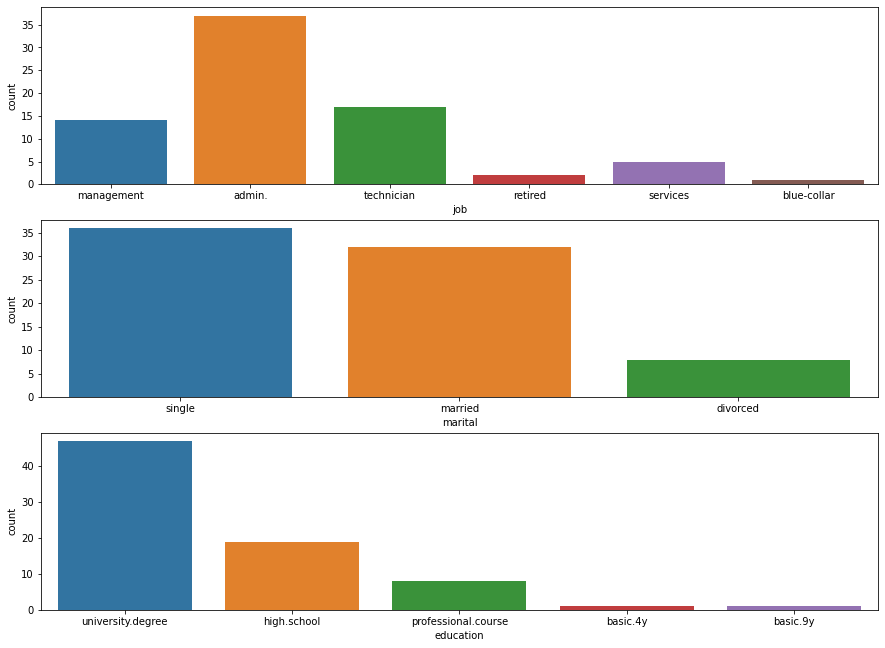

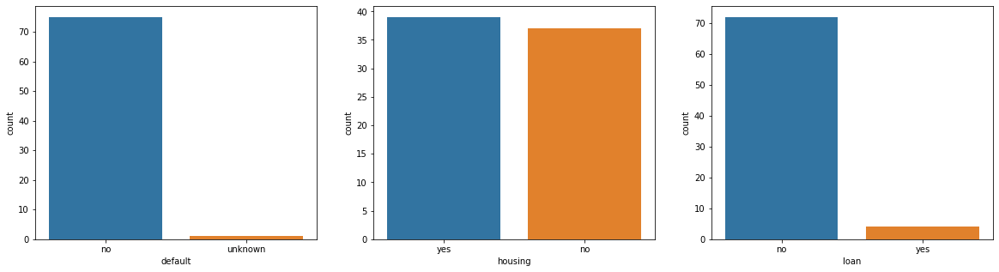

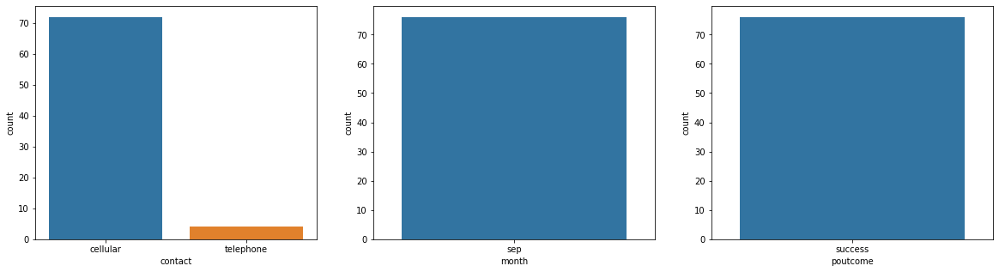

In [125]:
plt.figure(figsize=(15,15))
plt.subplot(4,1,1)
sns.countplot(X20['job'])
plt.subplot(4,1,2)
sns.countplot(X20['marital'])
plt.subplot(4,1,3)
sns.countplot(X20['education'])
fig, (ax1, ax2, ax3) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'default', data = X20, ax = ax1)
sns.countplot(x = 'housing', data = X20, ax = ax2)
sns.countplot(x = 'loan', data = X20, ax = ax3)
fig2, (ax4, ax5, ax6) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'contact', data = X20, ax = ax4)
sns.countplot(x = 'month', data = X20, ax = ax5)
sns.countplot(x = 'poutcome', data = X20, ax = ax6)

From the countplot we can see that most of the customers were contacted using cellular and poutcome is success. Also, most of the people had university degree with a job role of admin and did not defaulton loan.

In [126]:
X30 = dfcl.loc[dfcl['Cluster'] == 30]

#### Datapoints in cluster 30

In [127]:
pd.set_option('display.max_columns', None)
X30

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,Cluster
39152,33,admin.,married,university.degree,no,yes,no,cellular,mar,wed,235,3,4,1,success,-1.8,93.369,-34.8,0.655,5008.7,yes,30
39159,37,admin.,single,high.school,no,no,no,cellular,mar,wed,153,2,4,2,success,-1.8,93.369,-34.8,0.655,5008.7,yes,30
39164,34,technician,single,university.degree,no,yes,yes,cellular,mar,thu,221,3,3,2,success,-1.8,93.369,-34.8,0.654,5008.7,yes,30
39196,41,admin.,divorced,university.degree,no,yes,no,cellular,mar,fri,498,2,6,3,success,-1.8,93.369,-34.8,0.653,5008.7,yes,30
39208,27,services,single,university.degree,no,yes,no,cellular,mar,mon,104,1,6,1,success,-1.8,93.369,-34.8,0.652,5008.7,yes,30
39216,34,admin.,single,university.degree,no,no,no,telephone,mar,tue,225,1,3,1,success,-1.8,93.369,-34.8,0.652,5008.7,yes,30
39218,34,admin.,single,high.school,no,no,no,cellular,mar,tue,469,1,6,2,success,-1.8,93.369,-34.8,0.652,5008.7,yes,30
39220,34,admin.,single,university.degree,no,yes,no,cellular,mar,tue,568,1,6,3,success,-1.8,93.369,-34.8,0.652,5008.7,yes,30
39221,34,admin.,single,university.degree,no,no,no,cellular,mar,tue,241,1,6,1,success,-1.8,93.369,-34.8,0.652,5008.7,yes,30
39222,34,admin.,single,university.degree,no,yes,yes,cellular,mar,tue,301,1,3,2,success,-1.8,93.369,-34.8,0.652,5008.7,yes,30


#### Analyzing cluster 30 using countplot

<AxesSubplot:xlabel='poutcome', ylabel='count'>

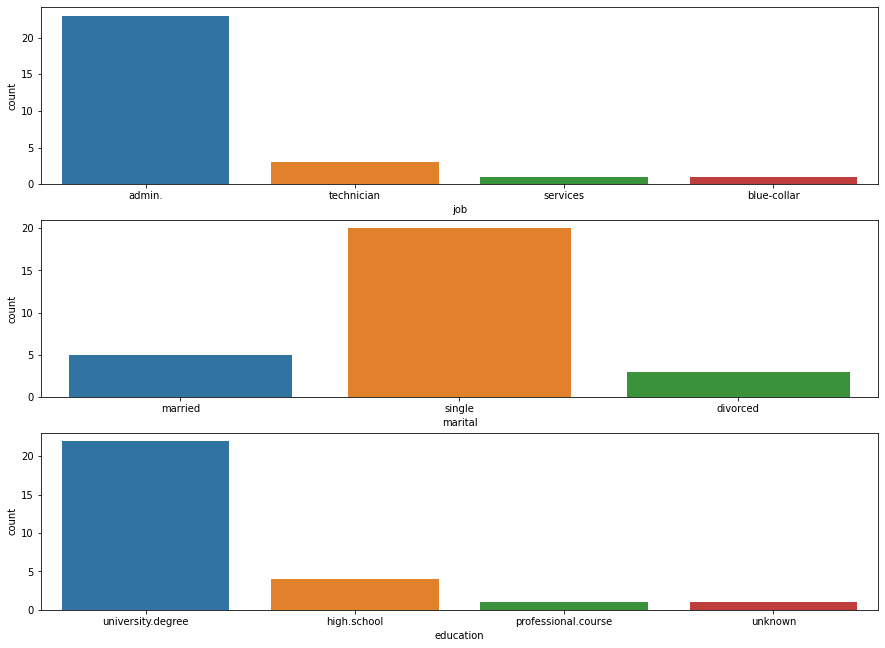

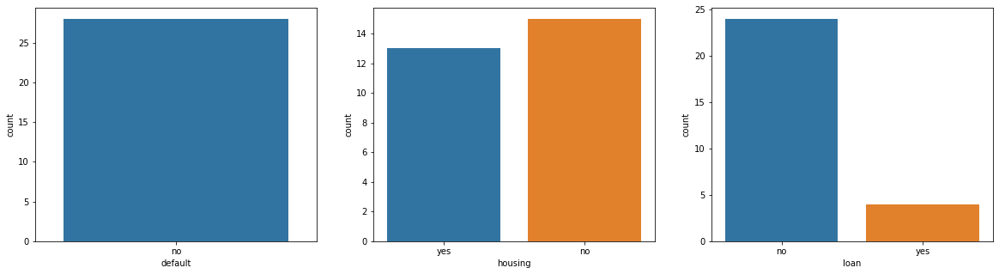

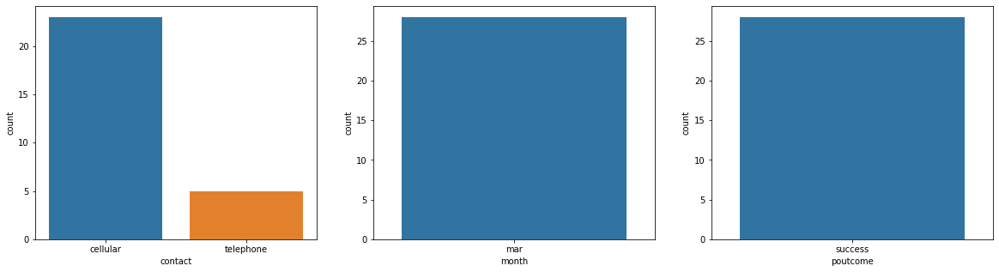

In [128]:
plt.figure(figsize=(15,15))
plt.subplot(4,1,1)
sns.countplot(X30['job'])
plt.subplot(4,1,2)
sns.countplot(X30['marital'])
plt.subplot(4,1,3)
sns.countplot(X30['education'])
fig, (ax1, ax2, ax3) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'default', data = X30, ax = ax1)
sns.countplot(x = 'housing', data = X30, ax = ax2)
sns.countplot(x = 'loan', data = X30, ax = ax3)
fig2, (ax4, ax5, ax6) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'contact', data = X30, ax = ax4)
sns.countplot(x = 'month', data = X30, ax = ax5)
sns.countplot(x = 'poutcome', data = X30, ax = ax6)

when compared to cluster 20 almost all the details are same and only difference is single people are more than married ones.

In [129]:
X31 = dfcl.loc[dfcl['Cluster'] == 31]

#### Datapoints in cluster 31

In [130]:
X31

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,Cluster
40866,32,technician,married,professional.course,no,no,no,cellular,oct,wed,311,1,3,1,success,-1.1,94.601,-49.5,0.959,4963.6,yes,31
40874,41,technician,married,professional.course,no,no,no,cellular,oct,wed,391,2,27,1,success,-1.1,94.601,-49.5,0.959,4963.6,yes,31
40885,28,admin.,single,university.degree,no,no,no,cellular,oct,thu,116,1,17,1,success,-1.1,94.601,-49.5,0.965,4963.6,no,31
40891,29,technician,married,professional.course,no,yes,no,cellular,oct,fri,319,1,5,2,success,-1.1,94.601,-49.5,0.972,4963.6,yes,31
40898,49,technician,divorced,professional.course,no,yes,no,cellular,oct,fri,251,2,3,1,success,-1.1,94.601,-49.5,0.972,4963.6,yes,31
40907,48,technician,married,professional.course,no,yes,yes,cellular,oct,mon,450,1,8,1,success,-1.1,94.601,-49.5,0.977,4963.6,yes,31
40912,33,services,single,university.degree,no,yes,no,cellular,oct,mon,252,2,3,2,success,-1.1,94.601,-49.5,0.977,4963.6,yes,31
40918,26,technician,single,professional.course,no,no,no,telephone,oct,mon,4,1,16,1,success,-1.1,94.601,-49.5,0.977,4963.6,no,31
40931,27,admin.,single,university.degree,no,yes,yes,cellular,oct,tue,242,1,3,2,success,-1.1,94.601,-49.5,0.982,4963.6,no,31
40940,49,admin.,married,high.school,unknown,no,no,cellular,oct,wed,169,1,6,3,success,-1.1,94.601,-49.5,0.985,4963.6,yes,31


#### Analyzing cluster 31 using countplot.

<AxesSubplot:xlabel='poutcome', ylabel='count'>

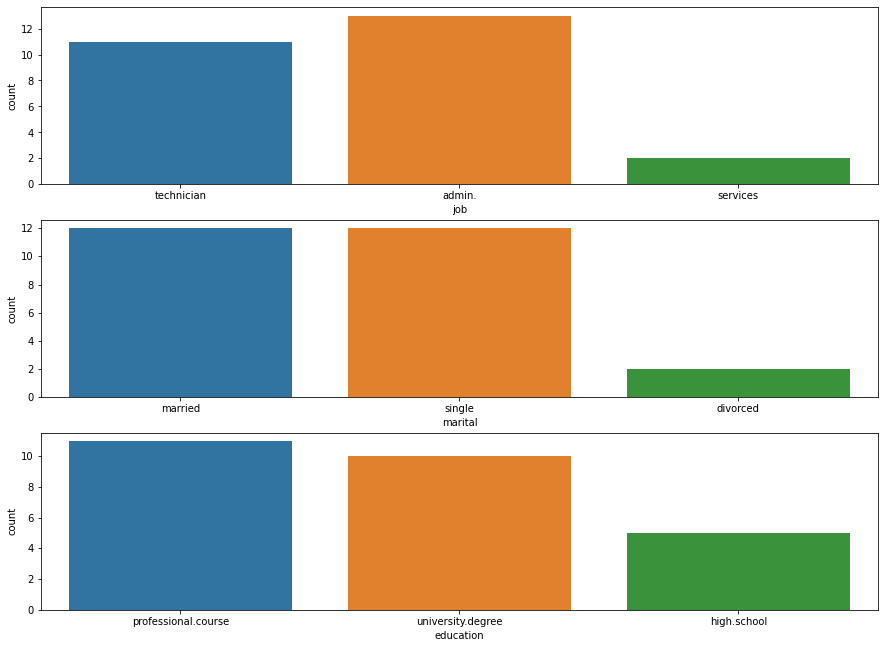

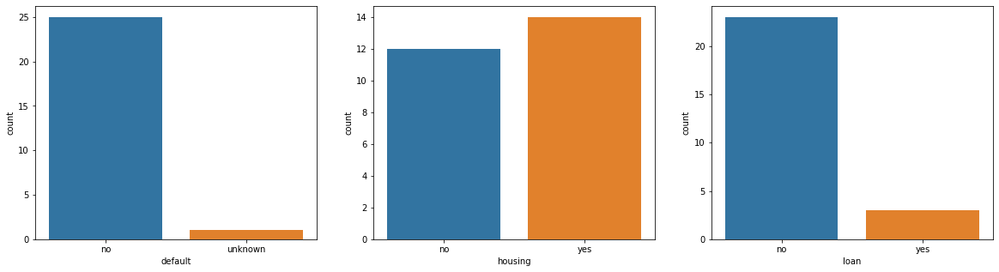

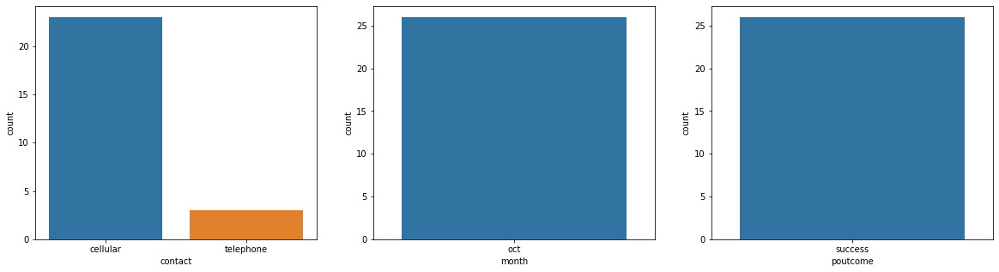

In [131]:
plt.figure(figsize=(15,15))
plt.subplot(4,1,1)
sns.countplot(X31['job'])
plt.subplot(4,1,2)
sns.countplot(X31['marital'])
plt.subplot(4,1,3)
sns.countplot(X31['education'])
fig, (ax1, ax2, ax3) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'default', data = X31, ax = ax1)
sns.countplot(x = 'housing', data = X31, ax = ax2)
sns.countplot(x = 'loan', data = X31, ax = ax3)
fig2, (ax4, ax5, ax6) = plt.subplots(nrows = 1, ncols = 3, figsize = (20,5))
sns.countplot(x = 'contact', data = X31, ax = ax4)
sns.countplot(x = 'month', data = X31, ax = ax5)
sns.countplot(x = 'poutcome', data = X31, ax = ax6)

Cluster 31 has customers who have completed professional courses and university degree. Also, they hold job role of technician and admin.

Combining the data of the clusters 20, 30 and 31 leads to a total count of 130 approx and this data is giving us important insights related to profiles that were successfully subscribing to term deposit. We should ask marketing team to design a special strategy to focus on such profiles in order to gain more number of subscriptions.

# Conclusion

1. Frequency of contact – keep it between 3-6 calls/customer.
2. Duration of the call – try to keep the customer involved for more than 10 minutes.
3. Target elderly group – talk less and high subscription ratio.
4. Target students and illiterate group – their subscription ratio is higher too.
5. Special strategy required for blue-collar workers and entrepreneurs as they subscribe less.
6. People who have not yet defaulted on any loan repayment are likely to subscribe.
7. Try contacting customers over cell phone than telephone.
8. Try contacting customers from last campaign and clients who subscribed to the previous campaign – subscription ratio is higher.
9. Try launching the campaign when the Euribor rate is lower.

# Deployment

https://p-bank-marketing.herokuapp.com/

# References:

- https://medium.com/@mohantysandip/a-step-by-step-approach-to-solve-dbscan-algorithms-by-tuning-its-hyper-parameters-93e693a91289
- https://scikit-learn.org/stable/
- https://plotly.com/python/
- https://matplotlib.org/stable/tutorials/introductory/usage.html- 
- https://seaborn.pydata.org/introduction.html
- https://scipy.github.io/devdocs/index.html
- https://stackoverflow.com/questions/19018333/gridsearchcv-on-logisticregression-in-scikit-learn
- https://stackoverflow.com/questions/53133930/how-to-use-the-best-parameter-as-parameter-of-a-classifier-in-gridsearchcv